In [1]:
from scipy.ndimage import shift

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


import os
import datetime

import IPython
import IPython.display
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler
mpl.rcParams['figure.figsize'] = (8, 6)
mpl.rcParams['axes.grid'] = False

import ta


# Load data do some feature engineering

In [2]:
data = pd.read_csv('/Users/tobiasleva/Desktop/Local_repo/archive/ml_df_daily_btc-oil-gold.csv')
sentiment = pd.read_csv('/Users/tobiasleva/Downloads/Gdelt_tone_2017_2023.csv')



In [3]:
#sentiment = sentiment.drop('Series',axis=1)

sentiment['date'] = sentiment['Date'].apply(pd.to_datetime)
data['date'] = data['date'].apply(pd.to_datetime)

all_data = pd.merge(data,sentiment,on='date',how='left')

all_data['Target_btc'] = all_data.Close_btc-all_data.Open_btc
all_data['Target_btc'] = all_data['Target_btc'].shift(-1)

all_data['TargetClass_btc'] = [ 1 if all_data.Target_btc[i]>0 
                          else 0 for i in range(all_data.shape[0])]

all_data = all_data.drop('Date',axis=1)
all_data['next_close'] = all_data['Close_btc'].shift(-1)

all_data.loc[:,'order_imbalance'] = (
    all_data.Close_btc-all_data.Open_btc)/(
        all_data.High_btc-all_data.Low_btc)

#scaler=MinMaxScaler()
    
#all_data.loc[:,'order_imbalance'] = scaler.fit_transform(
#    all_data.loc[:,'order_imbalance'].values[:,np.newaxis])

#data_sel = all_data.loc[:,['Close_btc','Close_gold','Close_oil',
#                           'Value','order_imbalance','Target_btc',
 #          'TargetClass_btc','date',]]

#data_sel = data_sel.fillna(method='ffill')

In [4]:
all_data = all_data.ffill()

In [5]:
import ta
rsi_period = 10


rsi =  ta.momentum.RSIIndicator(all_data['Close_btc'], window=rsi_period)
all_data.loc[:,'RSI_btc'] = rsi.rsi()

roc =  ta.momentum.ROCIndicator(all_data['Close_btc'], window=rsi_period)
all_data.loc[:,'ROC_btc'] = roc.roc()

obv =  ta.volume.on_balance_volume(all_data['Close_btc'], all_data['Volume_btc'])
all_data.loc[:,'OBV_btc'] = obv

rsi =  ta.momentum.RSIIndicator(all_data['Close_gold'], window=rsi_period)
all_data.loc[:,'RSI_gold'] = rsi.rsi()

roc =  ta.momentum.ROCIndicator(all_data['Close_gold'], window=rsi_period)
all_data.loc[:,'ROC_gold'] = roc.roc()

obv =  ta.volume.on_balance_volume(all_data['Close_gold'], all_data['Volume_gold'])
all_data.loc[:,'OBV_gold'] = obv

rsi =  ta.momentum.RSIIndicator(all_data['Close_oil'], window=rsi_period)
all_data.loc[:,'RSI_oil'] = rsi.rsi()

roc =  ta.momentum.ROCIndicator(all_data['Close_oil'], window=rsi_period)
all_data.loc[:,'ROC_oil'] = roc.roc()

obv =  ta.volume.on_balance_volume(all_data['Close_oil'], all_data['Volume_oil'])
all_data.loc[:,'OBV_oil'] = obv



In [6]:
all_data = all_data.bfill()

all_data.TargetClass_btc.value_counts()

all_data.info()

data_sel = all_data.drop('Series',axis=1)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2294 entries, 0 to 2293
Data columns (total 62 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   Open_btc           2294 non-null   float64       
 1   High_btc           2294 non-null   float64       
 2   Low_btc            2294 non-null   float64       
 3   Close_btc          2294 non-null   float64       
 4   Volume_btc         2294 non-null   float64       
 5   Open_oil           2294 non-null   float64       
 6   High_oil           2294 non-null   float64       
 7   Low_oil            2294 non-null   float64       
 8   Close_oil          2294 non-null   float64       
 9   Volume_oil         2294 non-null   float64       
 10  index              2294 non-null   float64       
 11  Open_gold          2294 non-null   float64       
 12  High_gold          2294 non-null   float64       
 13  Low_gold           2294 non-null   float64       
 14  Close_go

In [7]:
horizons = [2,5,10,20,40,60]

data_sel = data_sel.set_index('date')
variables = ['Close_btc','Close_gold','Close_oil','Value']

new_predictors = []

for v in variables:
    
    for hor in horizons:
        rolling_averages = data_sel.rolling(hor).mean()
        
        ratio_col = v+'_ratio_{}'.format(hor)
        data_sel.loc[:,ratio_col] = data_sel[v]/rolling_averages[v]
        
        trend_col = v+'_rTrend_{}'.format(hor)
        data_sel.loc[:,trend_col] = data_sel.shift(1).rolling(hor).sum(
                )['TargetClass_btc']
        new_predictors += [ratio_col, trend_col]

#data_sel = data_sel.dropna()

# Random Forest Classifier

In [8]:
data_sel = data_sel.fillna(method='bfill')

/var/folders/wn/7sysry195y72fj1pwfn2rt6h0000gn/T/ipykernel_95018/703598694.py:1: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data_sel = data_sel.fillna(method='bfill')


In [9]:
new_predictors = new_predictors+list(data_sel.columns)+variables

In [10]:
data_sel.isna().sum().unique()

array([0])

In [11]:
data_sel[data_sel==np.inf] = np.nan

In [12]:
data_sel = data_sel.fillna(method='bfill')

/var/folders/wn/7sysry195y72fj1pwfn2rt6h0000gn/T/ipykernel_95018/703598694.py:1: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data_sel = data_sel.fillna(method='bfill')


In [16]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score


def make_init_train_val_test(data_sel, init_factor, train_factor, val_factor):
    
    init_factor  = init_factor
    init_date    = data_sel.index[int(data_sel.shape[0] * init_factor)]
    
    train_factor = train_factor
    train_date = data_sel.index[int(data_sel.shape[0] * train_factor)]
    
    val_factor = val_factor
    val_date = data_sel.index[int(data_sel.shape[0] * val_factor)]
    
    
    X_init=data_sel.loc[:init_date].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_init=data_sel.loc[:init_date, 'TargetClass_btc']
    
    X_train =data_sel.loc[init_date:train_date].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_train =data_sel.loc[init_date:train_date, 'TargetClass_btc']
    
    X_val=data_sel.loc[train_date:val_date].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_val=data_sel.loc[train_date:val_date, 'TargetClass_btc']
    
    X_test=data_sel.loc[val_date:].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_test=data_sel.loc[val_date:, 'TargetClass_btc']

    return  X_init, y_init, X_train, y_train, X_val, y_val, X_test, y_test,init_date,train_date,val_date


def make_init_train_test_date(data_sel, init_date,train_date,val_date):
        
    
    X_init=data_sel.loc[:init_date].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_init=data_sel.loc[:init_date, 'TargetClass_btc']
    
    X_train =data_sel.loc[init_date:train_date].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_train =data_sel.loc[init_date:train_date, 'TargetClass_btc']
    
    X_val=data_sel.loc[train_date:val_date].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_val=data_sel.loc[train_date:val_date, 'TargetClass_btc']
    
    X_test=data_sel.loc[val_date:].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_test=data_sel.loc[val_date:, 'TargetClass_btc']

    return  X_init, y_init, X_train, y_train, X_val, y_val, X_test, y_test

def make_train_test_date(data_sel,train_date,):
        
    X_train =data_sel.loc[data_sel.date<train_date].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_train =data_sel.loc[data_sel.date<train_date, 'TargetClass_btc']
    
    
    X_test=data_sel.loc[data_sel.date>=train_date].drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)
    y_test=data_sel.loc[data_sel.date>=train_date, 'TargetClass_btc']

    return  X_train, y_train, X_test, y_test


def fit_predict(X_train_tmp, X_test_tmp, y_train_tmp, y_test_tmp, model,fit=True):
    
    if fit==True:
        model.fit(X_train_tmp, y_train_tmp)

    
    preds = model.predict(X_test_tmp)
    probs = model.predict_proba(X_test_tmp)

    combined = pd.concat([y_test_tmp.reset_index(drop=True),
                          pd.DataFrame(
                          preds, columns=['Predict']).reset_index(drop=True)]
                         , axis=1)
    
    
    return combined, pd.DataFrame(probs),model


def init_slicedtraining(data, model, predictors, target, start=10, step=1,scaler=False,init_factor=0.2,fit=None):
    
    all_predictions_val = []
    all_predictions_train = []
    
    all_probs_val = []
    all_probs_train = []



    X_train, y_train, X_test, y_test = make_train_test_date(data_sel.reset_index(),'2019-01-01')
    
    
    #X_init=scaler.fit_transform(X_init)
    #scaler.transform(test.values)
    #model.fit(X_init,y_init)

    X_train = X_train.drop('date',axis=1)
    X_test = X_test.drop('date',axis=1)

    for idx in range(start, X_train.shape[0], step):
      
        X_train_tmp = X_train.iloc[(idx-start):idx, :].copy(deep=True)
        X_test_tmp = X_train.iloc[idx:(idx+step), :].copy(deep=True)
        
        y_train_tmp = y_train.iloc[(idx-start):idx].copy(deep=True)
        y_test_tmp = y_train.iloc[idx:(idx+step)].copy(deep=True)

        X_train_tmp=scaler.fit_transform(X_train_tmp)
        X_test_tmp=scaler.transform(X_test_tmp)

        #return X_train_tmp, X_test_tmp, y_train_tmp, y_test_tmp
        
        predictions, probs,model = fit_predict(X_train_tmp, X_test_tmp, y_train_tmp, y_test_tmp, model,fit=True)
        
        all_predictions_train.append(predictions)
        all_probs_train.append(probs)
        

    for idx in range(start, X_test.shape[0], step):
      
        X_train_tmp = X_test.iloc[(idx-start):idx, :].copy(deep=True)
        X_test_tmp = X_test.iloc[idx:(idx+step), :].copy(deep=True)
        
        y_train_tmp = y_test.iloc[(idx-start):idx].copy(deep=True)
        y_test_tmp = y_test.iloc[idx:(idx+step)].copy(deep=True)

        X_train_tmp=scaler.fit_transform(X_train_tmp)
        X_test_tmp=scaler.transform(X_test_tmp)
        
        predictions, probs,model = fit_predict(X_train_tmp, X_test_tmp, y_train_tmp, y_test_tmp, model,fit=True)
        
        all_predictions_val.append(predictions)
        all_probs_val.append(probs)
 
    
        
        # Calculate precision for each iteration
        
    return pd.concat(all_predictions_train), pd.concat(all_probs_train),pd.concat(all_predictions_val), pd.concat(all_probs_val),model,



predictors = data_sel.drop(['Target_btc','TargetClass_btc'],axis=1).columns

target = 'TargetClass_btc'

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import precision_score

scaler = MinMaxScaler()
model = RandomForestClassifier()

all_prediction_train, all_probs_train, all_prediction_val, all_probs_val,model= init_slicedtraining(data_sel.reset_index(),
                                                                                                  model, predictors,
                                                                                                  target,scaler=scaler,fit=True)



# Evaluate Model 

In [49]:
precision_score(all_prediction_train.TargetClass_btc,
                all_prediction_train.Predict)

0.5420875420875421

In [50]:
precision_score(all_prediction_val.TargetClass_btc,
                all_prediction_val.Predict)

0.5214659685863874

In [19]:
from sklearn.metrics import classification_report,confusion_matrix

In [20]:
all_prediction_val.Predict.value_counts()

Predict
1    956
0    827
Name: count, dtype: int64

In [21]:
all_prediction_val.TargetClass_btc.value_counts()

TargetClass_btc
1    927
0    856
Name: count, dtype: int64

In [22]:
print(classification_report(all_prediction_train.TargetClass_btc,
                all_prediction_train.Predict))

              precision    recall  f1-score   support

           0       0.42      0.37      0.39       212
           1       0.56      0.62      0.59       279

    accuracy                           0.51       491
   macro avg       0.49      0.49      0.49       491
weighted avg       0.50      0.51      0.51       491



In [23]:
print(classification_report(all_prediction_val.TargetClass_btc,
                all_prediction_val.Predict))

              precision    recall  f1-score   support

           0       0.47      0.45      0.46       856
           1       0.51      0.52      0.52       927

    accuracy                           0.49      1783
   macro avg       0.49      0.49      0.49      1783
weighted avg       0.49      0.49      0.49      1783



In [24]:
import itertools

from matplotlib      import pyplot as plt
from sklearn.metrics import confusion_matrix


def plot_confusion_matrix(actual, predicted, classes=None,
                          normalize=False, title='Confusion matrix',
                          cmap=plt.cm.viridis, reversed=True,
                          figsize=(4, 4), fontsize=10, savefig=None):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    Source: 
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
    """
    cm = confusion_matrix(actual, predicted)

    if classes is None:
        classes = ['Class 0', 'Class 1']
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    if reversed:
        cmap = cmap.reversed()
    plt.figure(figsize=figsize)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, size=fontsize+4)
    plt.colorbar(aspect=4)
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45, size=fontsize)
    plt.yticks(tick_marks, classes, size=fontsize)
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    colors = ['white', 'black']
    if cmap.name == 'viridis':
        colors = ['red', 'red']
    # Labeling the plot
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), fontsize=fontsize+6,
                 horizontalalignment="center",
                 color=colors[0] if cm[i, j] > thresh else colors[1])
    plt.ylabel('True label',      size=fontsize+2)
    plt.xlabel('Predicted label', size=fontsize+2)
    #plt.grid(visible=False)
    plt.grid(False)
    #plt.grid(None)
    plt.tight_layout()
    
    if savefig is not None:
        plt.savefig(savefig, facecolor='white', bbox_inches='tight')
    plt.show()

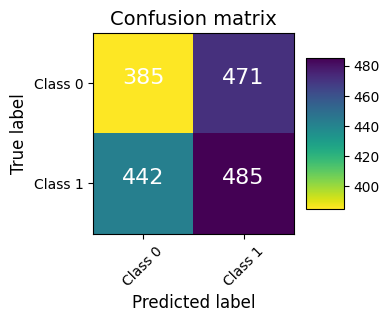

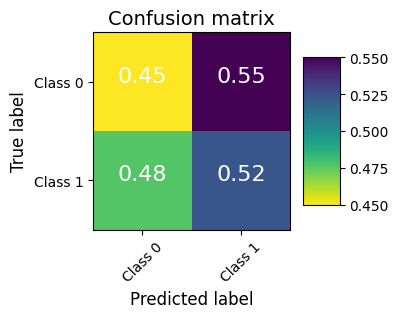

In [25]:
plot_confusion_matrix(all_prediction_val.TargetClass_btc,
                all_prediction_val.Predict)

plot_confusion_matrix(all_prediction_val.TargetClass_btc,
                all_prediction_val.Predict,normalize=True)

# develop trading stategy

<Axes: xlabel='1', ylabel='Count'>

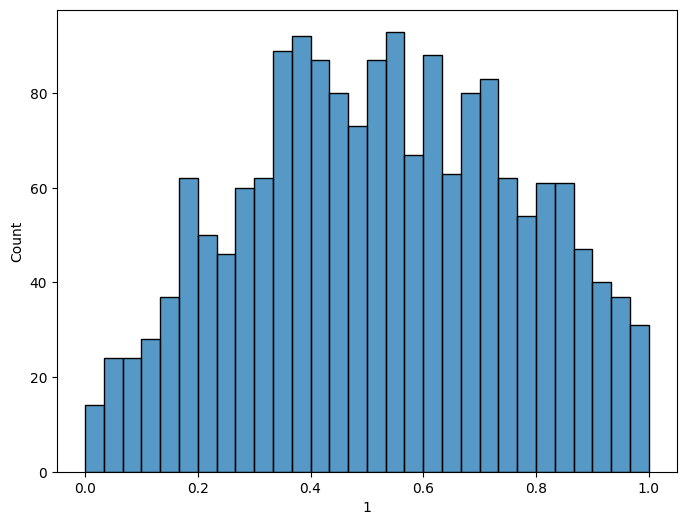

In [51]:
sns.histplot(all_probs_val.loc[:,1],bins=30)

In [ ]:
all_prediction_val

In [52]:
buy_mask = all_probs_val.loc[:,1].values > 0.6
sell_mask = all_probs_val.loc[:,1].values < 0.4

# Initialize strategy
actions= np.array(['hold'] * sell_mask.shape[0])

# Apply buy and sell strategies
actions[buy_mask] = 'buy'
actions[sell_mask] = 'sell'

In [53]:
all_probs_val.shape

(1783, 2)

In [55]:
X_train, y_train, X_test, y_test = make_train_test_date(data_sel.reset_index(),'2019-01-01')

In [56]:
X_train.shape

(501, 106)

In [57]:
strategy = pd.DataFrame([],columns=['date','actions'])

In [58]:
strategy.loc[:,'date'] = X_test.iloc[10:,:].date.values
strategy.loc[:,'actions'] = actions

In [59]:
strategy

,date,actions
0,2019-01-11,buy
1,2019-01-12,hold
2,2019-01-13,hold
3,2019-01-14,sell
4,2019-01-15,hold
...,...,...
1778,2023-11-24,hold
1779,2023-11-25,buy
1780,2023-11-26,buy
1781,2023-11-27,buy


In [60]:
strategy.to_csv('/Users/tobiasleva/Desktop/Local_repo/archive/RF_strategy_opt.csv')

# Optimize Model 

In [26]:
X = data_sel.drop(['Target_btc','TargetClass_btc', 'next_close'],axis=1)

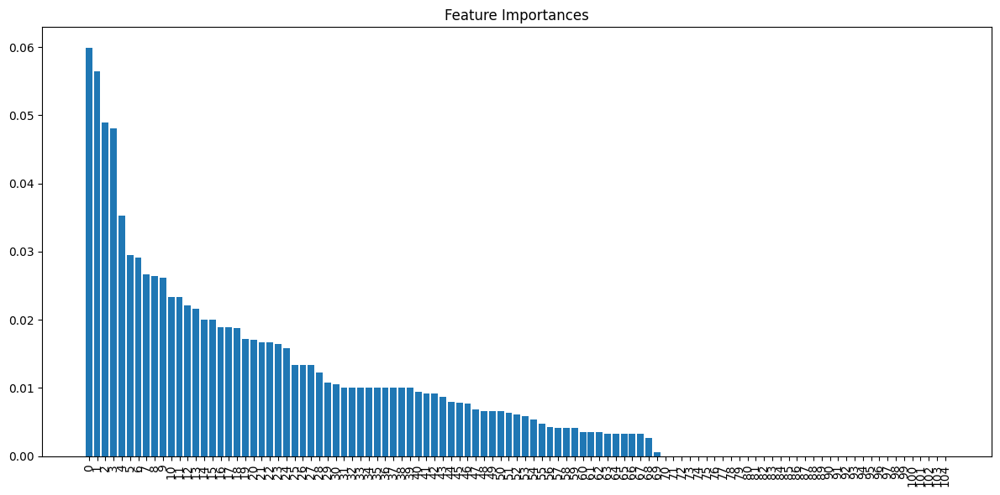

In [27]:

importances = model.feature_importances_

# Sort the feature importances in descending order
sorted_indices = np.argsort(importances)[::-1]

# Plot the feature importances
plt.figure(figsize=(12, 6))
plt.title('Feature Importances')
plt.bar(range(X.shape[1]), importances[sorted_indices], align='center')
#plt.xticks(range(X.shape[1]), X.columns[sorted_indices], rotation=90)
plt.xticks(range(X.shape[1]), range(X.shape[1]), rotation=90)
plt.tight_layout()
plt.show()


In [29]:
selected_deatures = X.columns[sorted_indices][:69]

In [30]:
selected_deatures

Index(['High_btc', 'OBV_btc', 'Close_gold_ratio_10', 'Close_btc_ratio_10',
       'Close_btc_ratio_5', 'HMA_btc', 'price_change_gold',
       'Close_gold_ratio_2', 'hc_change_oil', 'Close_oil_rTrend_60',
       'Value_rTrend_20', 'Volatility_gold', 'Close_oil_ratio_20',
       'Value_ratio_2', 'High_oil', 'Close_gold_rTrend_2',
       'Close_gold_ratio_60', 'Value_ratio_20', 'Value', 'Close_btc_rTrend_20',
       'WMA_oil', 'Z-Score_btc', 'Volatility_oil', 'Value_rTrend_2', 'CMO_btc',
       'Close_btc_rTrend_2', 'Z-Score_oil', 'Close_oil_ratio_60', 'High_gold',
       'Close_btc', 'order_imbalance', 'Volume_oil', 'Close_gold_rTrend_20',
       'Close_oil_rTrend_2', 'Close_oil_rTrend_20', 'ROC_oil', 'Value_ratio_5',
       'Close_btc_rTrend_60', 'OBV_oil', 'lc_change_gold', 'Value_rTrend_60',
       'WMA_btc', 'lc_change_oil', 'index', 'Close_gold_ratio_40',
       'Close_btc_ratio_40', 'Open_gold', 'Close_oil_ratio_5', 'RSI_btc',
       'price_change_btc', 'Close_btc_ratio_60', 'CMO_o

In [ ]:
tmp= [dates[i].date[0] for i in range(len(dates))]

all_probs.loc[:,'date'] = tmp

all_probs = all_probs.set_index('date')

all_probs = all_probs.drop(0,axis=1).rename(columns={1:'Rise_Prob'})

adj_preds = np.zeros(all_prediction.Predict.values.shape)
adj_preds[all_probs.loc[:,'Rise_Prob'].values < np.percentile(all_probs.loc[:,'Rise_Prob'].values,25)]= 1 
adj_preds[all_probs.loc[:,'Rise_Prob'].values > np.percentile(all_probs.loc[:,'Rise_Prob'].values,75)]= 2


all_probs.loc[:,'Action'] = adj_preds

sns.histplot(all_probs.Rise_Prob)

all_prediction

In [35]:
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

In [ ]:
predictors = data_sel.drop(['Target_btc','TargetClass_btc'],axis=1).columns

target = 'TargetClass_btc'

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import precision_score

param_grid = {
    'n_estimators': [int(x) for x in np.linspace(start=20, stop=400, num=5)],
    'max_depth': [int(x) for x in np.linspace(10, 110, num=5)] + [None],
    'min_samples_split': [10,100,200,500],
    'min_samples_leaf': [ 2, 10,100,200,500],
    'bootstrap': [True, False]}


scaler = MinMaxScaler()
rf = RandomForestClassifier()

# Random search of parameters
rf_random = RandomizedSearchCV(estimator=rf, param_distributions=param_grid,
                               n_iter=250, cv=3, verbose=10, random_state=42,
                               n_jobs=-1,error_score='raise')

all_prediction_train, all_probs_train, all_prediction_val, all_probs_val,model= init_slicedtraining(data_sel.reset_index(),
                                                                                                  rf_random, predictors,
                                                                                                  target,scaler=scaler,fit=True)

Fitting 3 folds for each of 500 candidates, totalling 1500 fits
Fitting 3 folds for each of 500 candidates, totalling 1500 fits
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=200, n_estimators=400; total time=   0.4s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=2, min_samples_split=2, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=357; total time=   0.2s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=100, min_samples_split=200, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=100, min_samples_split=200, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=100, min_samples_split=200, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=4, min_samples_split=200, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_dep

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=110, min_samples_leaf=1, min_samples_split=500, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=110, min_samples_leaf=1, min_samples_split=500, n_estimators=104; total time=   0.0s
[CV] END bootstrap=True, max_depth=110, min_samples_leaf=1, min_samples_split=500, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=500, min_samples_split=200, n_estimators=400; total time=   0.2s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=500, min_samples_split=200, n_estimators=400; total time=   0.2s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=500, min_samples_split=200, n_estimators=400; total time=   0.2s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=500, min_samples_split=2, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=200, min_samples_split=200, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, ma

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=5, min_samples_split=10, n_estimators=273; total time=   0.2s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=5, min_samples_split=10, n_estimators=273; total time=   0.2s
[CV] END bootstrap=False, max_depth=100, min_samples_leaf=1, min_samples_split=200, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=200, min_samples_split=5, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


_samples_split=2, n_estimators=400; total time=   0.3s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=200, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=200, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=200, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=100, min_samples_split=2, n_estimators=62; total time=   0.1s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=5, min_samples_split=5, n_estimators=231; total time=   0.1s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=5, min_samples_split=5, n_estimators=231; total time=   0.1s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=5, min_samples_split=5, n_estimators=231; total time=   0.1s
[CV] END bootstrap=False, max_depth=20, min_samples_leaf=4, min_samples_split=5, n_estimators=315; total time=

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=20, min_samples_leaf=100, min_samples_split=200, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=20, min_samples_leaf=100, min_samples_split=200, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=20, min_samples_leaf=100, min_samples_split=200, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=2, min_samples_split=500, n_estimators=104; total time=   0.0s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=2, min_samples_split=500, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=2, min_samples_split=500, n_estimators=104; total time=   0.0s
[CV] END bootstrap=False, max_depth=20, min_samples_leaf=5, min_samples_split=200, n_estimators=62; total time=   0.0s
[CV] END bootstrap=True, max_depth=80, min_samples_leaf=4, min_samples_split=2, n_estimators=231; total time=   0.2s
[CV] END bootstrap=True, max_depth=40, mi

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=90, min_samples_leaf=100, min_samples_split=10, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=100, min_samples_split=10, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=80, min_samples_leaf=200, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=100, min_samples_split=5, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=5, min_samples_split=10, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=2, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=2, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=110, min_samples_leaf=200, min_samples_split=100, n_estimators=231; total time=   0.2s
[CV] END bootstrap=True, max_depth=110, min_sa

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=70, min_samples_leaf=2, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=100, min_samples_split=200, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=100, min_samples_split=200, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=500, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=500, n_estimators=62; total time=   0.0s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=5, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=100, min_samples_split=500, n_estimators=62; total time=   0.0s
[CV] END bootstrap=True, max_depth=110, min_samples_leaf=500, min_samples_split=2, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=110,

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=62; total time=   0.0s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=4, min_samples_split=100, n_estimators=273; total time=   0.2s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=4, min_samples_split=100, n_estimators=273; total time=   0.2s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=500, min_samples_split=5, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=1, min_samples_split=100, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=100, min_samples_split=500, n_estimators=357; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=100, min_samples_split=500, n_estimators=357; total time=   0.3s
[CV] END bootstrap=False, max_depth=40, mi

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=50, min_samples_leaf=5, min_samples_split=10, n_estimators=273; total time=   0.2s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=5, min_samples_split=10, n_estimators=273; total time=   0.2s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=200, min_samples_split=500, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=200, min_samples_split=500, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=500, min_samples_split=5, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=500, min_samples_split=5, n_estimators=104; total time=   0.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=188; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=188; total time=   0.2s
[CV] END bootstrap=False, max_depth=70, min_

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=60, min_samples_leaf=2, min_samples_split=5, n_estimators=273; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=90, min_samples_leaf=200, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=90, min_samples_leaf=200, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=500, min_samples_split=2, n_estimators=273; total time=   0.3s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=500, min_samples_split=2, n_estimators=273; total time=   0.3s
[CV] END bootstrap=True, max_depth=60, min_samples_leaf=5, min_samples_split=10, n_estimators=146; total time=   0.2s
[CV] END bootstrap=True, max_depth=60, min_s

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=40, min_samples_leaf=500, min_samples_split=10, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=500, min_samples_split=10, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=5, min_samples_split=2, n_estimators=400; total time=   0.2s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=5, min_samples_split=2, n_estimators=400; total time=   0.2s
[CV] END bootstrap=True, max_depth=60, min_samples_leaf=4, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=60, min_samples_leaf=4, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=60, min_samples_leaf=4, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=231; total time=   0.2s
[CV] END bootstrap=True, max_depth=30, min_samples_l

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=200, n_estimators=400; total time=   0.4s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=2, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=False, max_depth=60, min_samples_leaf=2, min_samples_split=5, n_estimators=273; total time=   0.2s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=500, min_samples_split=2, n_estimators=273; total time=   0.3s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=500, min_samples_split=2, n_estimators=273; total time=   0.2s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=500, min_samples_split=2, n_estimators=273; total time=   0.2s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=1, min_samples_split=100, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=4, min_samples_split=5, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=100, min_samples

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=80, min_samples_leaf=500, min_samples_split=5, n_estimators=315; total time=   0.2s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=200, n_estimators=400; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=2, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=2, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=1, min_samples_split=100, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=1, min_samples_split=100, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=5, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=5, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=100, min_samples

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=70, min_samples_leaf=500, min_samples_split=2, n_estimators=273; total time=   0.2s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=1, min_samples_split=100, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=4, min_samples_split=5, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=100, min_samples_leaf=100, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=100, min_samples_leaf=100, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=100, min_samples_leaf=100, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=5, min_samples_split=5, n_estimators=273; total time=   0.1s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=5, min_samples_split=5, n_estimators=273; total time=   0.2s
[CV] END bootstrap=False, max_depth=70,

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=100, min_samples_leaf=5, min_samples_split=500, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=100, min_samples_leaf=5, min_samples_split=500, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=4, min_samples_split=100, n_estimators=357; total time=   0.3s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=4, min_samples_split=100, n_estimators=357; total time=   0.3s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=1, min_samples_split=5, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=1, min_samples_split=5, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=100, n_estimators=273; total time=   0.2s
[CV] END bootstrap=False, max_depth=20, min_samples_leaf=1, min_samples_split=200, n_estimators=188; total time=   0.1s
[CV] END bootstrap=False, max_depth=20, min_samples

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=110, min_samples_leaf=4, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=100, min_samples_leaf=4, min_samples_split=10, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=100, min_samples_leaf=4, min_samples_split=10, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=100, min_samples_leaf=4, min_samples_split=10, n_estimators=62; total time=   0.1s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=500, min_samples_split=10, n_estimators=315; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=5, min_samples_split=500, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=5, min_samples_split=500, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=5, min_samples_split=500, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=40, min_s

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=10, n_estimators=400; total time=   0.3s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=10, n_estimators=400; total time=   0.3s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=5, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=5, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=60, min_samples_leaf=5, min_samples_split=200, n_estimators=188; total time=   0.3s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=200, min_samples_split=2, n_estimators=146; total time=   0.2s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=200, min_samples_split=2, n_estimators=146; total time=   0.2s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=200, min_samples_split=2, n_estimators=146; total time=   0.2s
[CV] END bootstrap=False, max_depth=40, min_sampl

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=10, min_samples_leaf=200, min_samples_split=200, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=2, min_samples_split=10, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=1, min_samples_split=10, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=20, min_samples_leaf=100, min_samples_split=2, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=20, min_samples_leaf=100, min_samples_split=2, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=200, min_samples_split=500, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=100, min_samples_split=5, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=500, min_samples_split=2, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=10, min_

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=500, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=500, n_estimators=62; total time=   0.0s
[CV] END bootstrap=True, max_depth=110, min_samples_leaf=500, min_samples_split=2, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=110, min_samples_leaf=2, min_samples_split=10, n_estimators=188; total time=   0.1s
[CV] END bootstrap=False, max_depth=110, min_samples_leaf=2, min_samples_split=10, n_estimators=188; total time=   0.1s
[CV] END bootstrap=False, max_depth=110, min_samples_leaf=2, min_samples_split=10, n_estimators=188; total time=   0.2s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=500, min_samples_split=10, n_estimators=62; total time=   0.2s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=500, min_samples_split=10, n_estimators=62; total time=   0.1s
[CV] END bootstrap=False, max_depth=30,

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=5, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=5, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=60, min_samples_leaf=4, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=231; total time=   0.2s
[CV] END bootstrap=True, max_depth=100, min_samp

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=40, min_samples_leaf=200, min_samples_split=500, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=200, min_samples_split=2, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=200, min_samples_split=2, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=100, min_samples_split=10, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=1, min_samples_split=100, n_estimators=188; total time=   0.2s
[CV] END bootstrap=True, max_depth=80, min_samples_leaf=500, min_samples_split=5, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=200, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=200, n_estimators=400; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=80, min_samples_leaf=4, min_samples_split=200, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=100, min_samples_split=200, n_estimators=188; total time=   0.2s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=4, min_samples_split=100, n_estimators=273; total time=   0.2s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=4, min_samples_split=100, n_estimators=273; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=4, min_samples_split=100, n_estimators=273; total time=   0.3s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=10, n_estimators=400; total time=   0.3s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=200, min_samples_split=2, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=200, min_samples_split=2, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_s

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=5, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=5, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=60, min_samples_leaf=4, min_samples_split=2, n_estimators=315; total time=   0.2s
[CV] END bootstrap=True, max_depth=60, min_samples_leaf=4, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=200, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=200, n_estimators=400; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=2, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=2, min_samples_split=2, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=500, min_samples_split=2, n_estimators=273; total time=   0.3s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=1, min_samples_split=100, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=100, min_samples_leaf=2, min_samples_split=5, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=100, min_samples_leaf=2, min_samples_split=5, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=80, min_sample

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=20, min_samples_leaf=4, min_samples_split=100, n_estimators=273; total time=   0.2s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=10, n_estimators=400; total time=   0.3s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=500, min_samples_split=5, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=500, min_samples_split=5, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=60, min_samples_leaf=5, min_samples_split=200, n_estimators=188; total time=   0.1s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=200, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=500, min_samples_split=500, n_estimators=231; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=500, min_samples_split=500, n_estimators=231; total time=   0.2s
[CV] END bootstrap=True, max_depth=

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=100, min_samples_leaf=5, min_samples_split=500, n_estimators=188; total time=   0.1s
[CV] END bootstrap=False, max_depth=20, min_samples_leaf=500, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=20, min_samples_leaf=500, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=200, min_samples_split=2, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=4, min_samples_split=500, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=110, min_samples_leaf=500, min_samples_split=10, n_estimators=357; total time=   0.3s
[CV] END bootstrap=True, max_depth=110, min_samples_leaf=500, min_samples_split=5, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=500, min_samples_split=2, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=1

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=10, min_samples_leaf=200, min_samples_split=200, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=2, min_samples_split=10, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=2, min_samples_split=10, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=1, min_samples_split=500, n_estimators=188; total time=   0.2s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=1, min_samples_split=500, n_estimators=188; total time=   0.2s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=500, min_samples_split=200, n_estimators=400; total time=   0.3s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=500, min_samples_split=2, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=10, min_s

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=80, min_samples_leaf=500, min_samples_split=5, n_estimators=315; total time=   0.2s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=100, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=2, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=100, min_samples_split=5, n_estimators=62; total time=   0.1s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=5, min_samples_split=10, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=2, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=2, min_samples_split=2, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=100, min_samples_split=200, n_estimators=146; total time=   0.2s
[CV] END bootstrap=True, max_depth=110, min_samp

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=100, min_samples_leaf=2, min_samples_split=200, n_estimators=357; total time=   0.2s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=100, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=2, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=2, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=5, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=5, min_samples_split=200, n_estimators=315; total time=   0.4s
[CV] END bootstrap=False, max_depth=90, min_samples_leaf=200, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=500, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=Non

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=60, min_samples_leaf=5, min_samples_split=200, n_estimators=188; total time=   0.1s
[CV] END bootstrap=True, max_depth=100, min_samples_leaf=4, min_samples_split=500, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=100, min_samples_leaf=4, min_samples_split=500, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=200, min_samples_split=2, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=200, min_samples_split=2, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=100, min_samples_split=10, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=100, min_samples_split=10, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=80, min_samples_leaf=500, min_samples_split=5, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=None, m

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=80, min_samples_leaf=200, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=80, min_samples_leaf=200, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=500, min_samples_split=5, n_estimators=273; total time=   0.2s
[CV] END bootstrap=False, max_depth=90, min_samples_leaf=2, min_samples_split=200, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=90, min_samples_leaf=2, min_samples_split=200, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=90, min_samples_leaf=2, min_samples_split=200, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=110, min_samples_leaf=4, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=110, min_samples_leaf=4, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=50,

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=60, min_samples_leaf=1, min_samples_split=500, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=60, min_samples_leaf=1, min_samples_split=500, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=80, min_samples_leaf=500, min_samples_split=5, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=200, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=100, min_samples_split=10, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=80, min_samples_leaf=200, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=100, min_samples_split=5, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=100, min_samples_split=5, n_estimators=62; total time=   0.0s
[CV] END bootstrap=True, max_depth=100, min_sam

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=110, min_samples_leaf=4, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=110, min_samples_leaf=4, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=110, min_samples_leaf=4, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=5, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=5, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=5, min_samples_split=100, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=None, 

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=357; total time=   0.3s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=200, min_samples_split=200, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=100, min_samples_leaf=2, min_samples_split=5, n_estimators=357; total time=   0.2s
[CV] END bootstrap=False, max_depth=100, min_samples_leaf=2, min_samples_split=5, n_estimators=357; total time=   0.2s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=500, min_samples_split=2, n_estimators=315; total time=   0.2s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=4, min_samples_split=200, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=5, min_samples_split=200, n_estimators=400; total time=   0.2s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=5, min_samples_split=200, n_estimators=400; total time=   0.2s
[CV] END bootstrap=True, max_depth=110, m

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=100, min_samples_leaf=100, min_samples_split=2, n_estimators=357; total time=   0.3s
[CV] END bootstrap=True, max_depth=80, min_samples_leaf=500, min_samples_split=5, n_estimators=315; total time=   0.2s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=100, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=80, min_samples_leaf=200, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=5, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=5, min_samples_split=200, n_estimators=315; total time=   0.3s
[CV] END bootstrap=False, max_depth=90, min_samples_leaf=200, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=500, n_estimators=62; total time=   0.0s
[CV] END bootstrap=False, max_depth=None

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=90, min_samples_leaf=2, min_samples_split=10, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=2, min_samples_split=10, n_estimators=146; total time=   0.2s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=1, min_samples_split=500, n_estimators=188; total time=   0.2s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=1, min_samples_split=500, n_estimators=188; total time=   0.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=100, min_samples_split=5, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=100, min_samples_split=5, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=2, min_samples_split=200, n_estimators=315; total time=   0.4s
[CV] END bootstrap=True, max_depth=90, min_samples_leaf=2, min_samples_split=200, n_estimators=315; total time=   0.4s
[CV] END bootstrap=False, max_depth=30, min_samp

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=20, min_samples_leaf=4, min_samples_split=100, n_estimators=273; total time=   0.3s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=4, min_samples_split=10, n_estimators=400; total time=   0.3s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=500, min_samples_split=5, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=1, min_samples_split=100, n_estimators=146; total time=   0.1s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=100, min_samples_split=500, n_estimators=357; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=100, min_samples_split=500, n_estimators=357; total time=   0.3s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=2, min_samples_split=200, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=2, min_samples_split=200, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=10

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=False, max_depth=10, min_samples_leaf=1, min_samples_split=10, n_estimators=231; total time=   0.1s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=1, min_samples_split=10, n_estimators=231; total time=   0.2s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=200, min_samples_split=200, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=100, min_samples_split=500, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=1, min_samples_split=10, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=70, min_samples_leaf=1, min_samples_split=10, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=5, min_samples_split=100, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=5, min_samples_split=100, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=40, min_s

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=40, min_samples_leaf=200, min_samples_split=5, n_estimators=231; total time=   0.2s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=2, min_samples_split=500, n_estimators=357; total time=   0.3s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=2, min_samples_split=500, n_estimators=357; total time=   0.3s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=2, min_samples_split=200, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=2, min_samples_split=100, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=70, min_samples_leaf=2, min_samples_split=100, n_estimators=62; total time=   0.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=5, n_estimators=20; total time=   0.0s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf

/Users/tobiasleva/miniconda3/lib/python3.11/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=357; total time=   0.2s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=5, min_samples_split=100, n_estimators=104; total time=   0.1s
[CV] END bootstrap=False, max_depth=80, min_samples_leaf=100, min_samples_split=500, n_estimators=62; total time=   0.0s
[CV] END bootstrap=True, max_depth=110, min_samples_leaf=500, min_samples_split=2, n_estimators=20; total time=   0.0s
[CV] END bootstrap=False, max_depth=110, min_samples_leaf=2, min_samples_split=10, n_estimators=188; total time=   0.1s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=200, min_samples_split=100, n_estimators=357; total time=   0.3s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=5, min_samples_split=10, n_estimators=146; total time=   0.1s
[CV] END bootstrap=False, max_depth=30, mi

In [41]:
mod1 = rf_random.best_estimator_

In [42]:
all_prediction_train, all_probs_train, all_prediction_val, all_probs_val,model= init_slicedtraining(data_sel.reset_index(),
                                                                                                  mod1, predictors,
                                                                                                  target,scaler=scaler,fit=True)

In [43]:
precision_score(all_prediction_val.TargetClass_btc,
                all_prediction_val.Predict)

0.5214659685863874

In [45]:
mod1.feature_importances_

array([0.00798097, 0.07769219, 0.0027511 , 0.07329599, 0.00077809,
       0.00310124, 0.02724423, 0.00389045, 0.00136166, 0.00190632,
       0.00155618, 0.00165344, 0.00081699, 0.00077809, 0.00155618,
       0.00311236, 0.        , 0.        , 0.        , 0.00461296,
       0.01723467, 0.01760704, 0.00887021, 0.00155618, 0.06808279,
       0.00252879, 0.00077809, 0.00297341, 0.00316238, 0.0342248 ,
       0.00824774, 0.00392935, 0.00235094, 0.00389045, 0.00140056,
       0.00836446, 0.00443233, 0.0034625 , 0.00311236, 0.0030012 ,
       0.01182695, 0.00233427, 0.00077809, 0.00252879, 0.00155618,
       0.00517429, 0.00311236, 0.02529623, 0.        , 0.00690554,
       0.06852741, 0.00223701, 0.00268441, 0.01163243, 0.0017507 ,
       0.01199924, 0.01122116, 0.00330688, 0.00490196, 0.00994009,
       0.        , 0.01003735, 0.00197301, 0.00389045, 0.00462963,
       0.        , 0.00155618, 0.00213974, 0.00735294, 0.03634231,
       0.00840336, 0.02861144, 0.        , 0.05108154, 0.00097

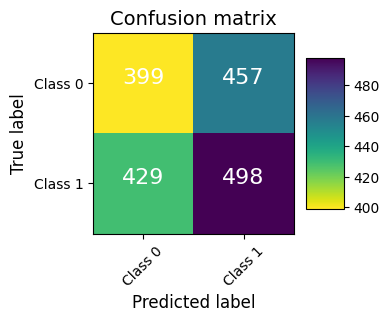

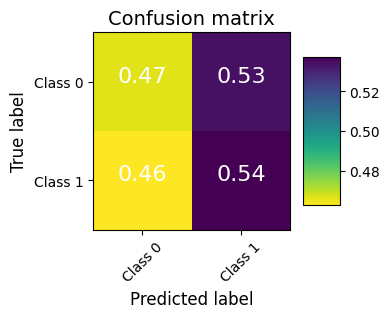

In [47]:
plot_confusion_matrix(all_prediction_val.TargetClass_btc,
                all_prediction_val.Predict)

plot_confusion_matrix(all_prediction_val.TargetClass_btc,
                all_prediction_val.Predict,normalize=True)

In [48]:
print(classification_report(all_prediction_val.TargetClass_btc,
                all_prediction_val.Predict))

              precision    recall  f1-score   support

           0       0.48      0.47      0.47       856
           1       0.52      0.54      0.53       927

    accuracy                           0.50      1783
   macro avg       0.50      0.50      0.50      1783
weighted avg       0.50      0.50      0.50      1783



In [ ]:
data_sel.shape

In [ ]:
data_sel.drop(['Target_btc','next_close'],axis=1
             ).to_csv(
                '/Users/tobiasleva/Desktop/Local_repo/archive/rf_df_141223.csv')

In [84]:
predicted = data_sel.TargetClass_btc.shift(1)

In [85]:
data_baseline = pd.DataFrame([],columns=['date','TargetClass_btc','Predict'])

data_baseline.loc[:,'date'] = predicted.index

In [86]:

data_baseline.loc[:,'TargetClass_btc'] = data_sel.TargetClass_btc.values
data_baseline.loc[:,'Predict'] = predicted.values.astype(int)

/var/folders/wn/7sysry195y72fj1pwfn2rt6h0000gn/T/ipykernel_95018/1088388459.py:2: RuntimeWarning: invalid value encountered in cast
  data_baseline.loc[:,'Predict'] = predicted.values.astype(int)


In [87]:
data_baseline = data_baseline.dropna()

In [88]:
data_baseline.Predict.unique()

array([0, 1], dtype=object)

In [89]:
data_baseline.TargetClass_btc.unique()

array([1, 0], dtype=object)

In [92]:
precision_score(data_baseline.Predict,
               data_baseline.TargetClass_btc)

ValueError: unknown is not supported

In [94]:
md_data = pd.read_feather('/Users/tobiasleva/Downloads/tf_predictions.feather')

In [97]:
precision_score(md_data.trend,
               md_data.predicted)

0.569377990430622

In [98]:
precision_score(all_prediction_val.TargetClass_btc,
                all_prediction_val.Predict)

0.5214659685863874

In [108]:
precision_score(data_baseline.TargetClass_btc.to_list(),
                data_baseline.Predict.to_list())

0.509016393442623

In [123]:
res= pd.DataFrame([],columns = ['model','precision'])

res.loc[:,'model'] = ['Baseline','Random Forest','LSTM-FCN']
res.loc[:,'Precision'] = [precision_score(data_baseline.TargetClass_btc.to_list(),
                            data_baseline.Predict.to_list()),
                         precision_score(all_prediction_val.TargetClass_btc,
                        all_prediction_val.Predict),
                         precision_score(md_data.trend,
                           md_data.predicted)]



In [162]:
res.iloc[0,2].round(3)

0.509

/var/folders/wn/7sysry195y72fj1pwfn2rt6h0000gn/T/ipykernel_95018/3224323151.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['Baseline','Random Forest','LSTM-FCN'], fontsize=13)


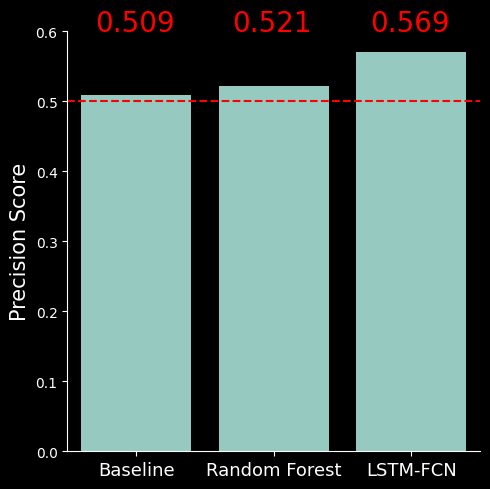

In [171]:
plt.style.use('dark_background')

fig, ax = plt.subplots(1, 1, figsize=(5, 5))

sns.barplot(data=res,x='model',y='Precision')
ax.set_xlabel('')
ax.axhline(.5, ls='--',color='red')

ax.set_ylabel('Precision Score', fontsize=15)
ax.set_xticklabels(['Baseline','Random Forest','LSTM-FCN'], fontsize=13)

ax.set_yticks(np.linspace(0,0.6,7))

ax.text(-.3,0.6,'{}'.format(res.iloc[0,2].round(3)),color='red',fontsize=20)
ax.text(.7,0.6,'{}'.format(res.iloc[1,2].round(3)),color='red',fontsize=20)
ax.text(1.7,0.6,'{}'.format(res.iloc[2,2].round(3)),color='red',fontsize=20)

sns.despine()
plt.tight_layout()
plt.savefig(r'/Users/tobiasleva/Desktop/model_comp.png')

plt.show()

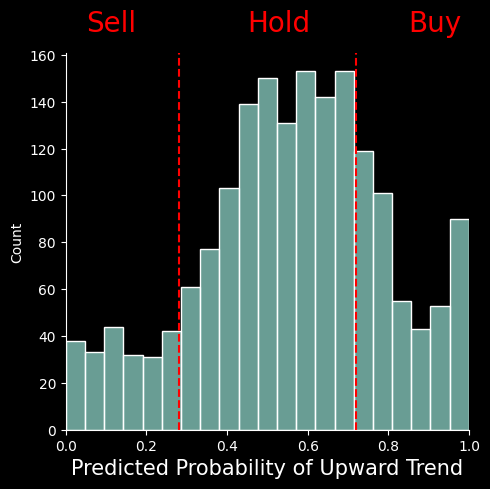

In [144]:
plt.style.use('dark_background')

fig, ax = plt.subplots(1, 1, figsize=(5, 5))

sns.histplot(data=md_data,x='proba')
ax.set_xlabel('Predicted Probability of Upward Trend' ,
             fontsize=15)
ax.set_xlim(0,1)
ax.axvline(.72, ls='--',color='red')
ax.axvline(.28, ls='--',color='red')
ax.text(0.05,170,'Sell',color='red',fontsize=20)
ax.text(0.45,170,'Hold',color='red',fontsize=20)
ax.text(0.85,170,'Buy',color='red',fontsize=20)
sns.despine()

plt.tight_layout()
plt.savefig(r'/Users/tobiasleva/Desktop/model_probs.png')

plt.show()

<Axes: xlabel='proba', ylabel='Count'>

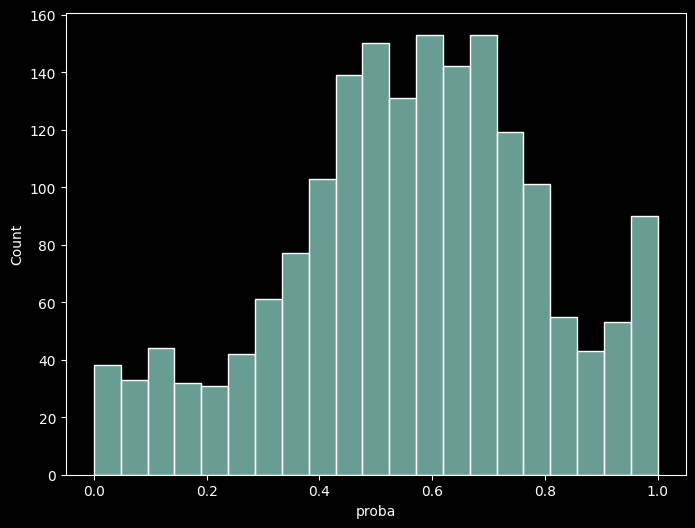

In [128]:
sns.histplot(md_data.proba)

,TargetClass_btc,Predict
0,0,1
0,0,0
0,1,1
0,0,0
0,1,1
...,...,...
0,1,1
0,0,1
0,0,1
0,1,1
